# SMART Protocol Simulation
This notebook simulates the SMART protocol for electron spin control.

In [3]:
import numpy as np
from scipy.integrate import solve_ivp
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from quantum_classes import *
from pauli_matrices import *

## Define System Parameters
Set up the frequencies and system parameters for the SMART protocol.

In [4]:
# Define frequencies
natural_freq = 10 * 10**9
driving_freq = 10 * 10**9
rabi_freq = 5 * 10**6   # Rabi frequency
modulation_freq = rabi_freq/2.404826 # Modulation frequency

# Initialize Hamiltonian and Quantum System
hamiltonian = Quantum_Hamiltonian(rabi_freq, 1, np.array([natural_freq]))
system = Quantum_System(hamiltonian, 1)


## Time Evolution
Evolve the system in both lab frame and rotating frame (RWA).

In [5]:
evaluation_points = 1000
evaluation_time = 5*10**-6
initial_state = np.array([1 + 0j, 0 + 0j])

In [53]:
# Evolve state in lab frame
t, y_lab = system.evolve_state(initial_state, evaluation_time, evaluation_points, 
                              ham_type='smart_lab',
                              driving_freq=driving_freq,
                              modulation_freq=modulation_freq
                             )


In [52]:

# Evolve state in rotating frame (RWA)
t, y_rwa = system.evolve_state(initial_state, evaluation_time, evaluation_points, 
                              ham_type='smart_rwa',
                              driving_freq=driving_freq,
                              modulation_freq=modulation_freq
                              )

A note on the time difference - over 70+times faster in rwa

## Visualization
Plot the results and visualize on the Bloch sphere.

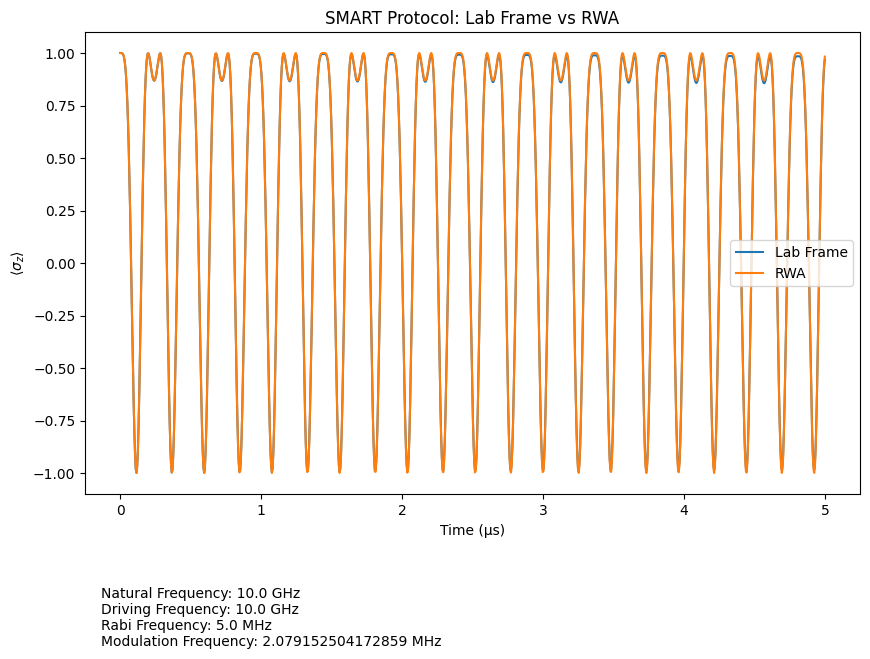

In [54]:
# Convert time to microseconds for plotting
t_micro = t * 10**6

# Calculate z-expectation values
z_expectation_lab = np.real(calculate_z_expectation(y_lab))
z_expectation_rwa = np.real(calculate_z_expectation(y_rwa))

# Plot results
plt.figure(figsize=(10, 6))
plt.plot(t_micro, z_expectation_lab, label='Lab Frame')
plt.plot(t_micro, z_expectation_rwa, label='RWA')
plt.xlabel('Time (µs)')
plt.ylabel(r'$\langle\sigma_z\rangle$')
plt.title('SMART Protocol: Lab Frame vs RWA')
plt.legend()

# Add metadata/caption with relevant frequencies
metadata = (f"Natural Frequency: {natural_freq / 1e9} GHz\n"
           f"Driving Frequency: {driving_freq / 1e9} GHz\n"
           f"Rabi Frequency: {rabi_freq / 1e6} MHz\n"
           f"Modulation Frequency: {modulation_freq / 1e6} MHz")

plt.text(0.02, -0.2, metadata, transform=plt.gca().transAxes, 
         fontsize=10, verticalalignment='top')
plt.show()

In [55]:
# Visualize evolution on Bloch sphere
system.visualise_solution(t, y_lab)

KeyboardInterrupt: 

In [56]:
system.visualise_solution(t, y_rwa)

Animation size has reached 21027697 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [57]:

# Define a range of driving frequencies
driving_freqs = np.linspace(9.99e9, 10.01e9, 1000)  # from 9 GHz to 11 GHz

# Initialize a list to store the z expectation values for each driving frequency
z_expectations = []

# Loop through each driving frequency
for freq in driving_freqs:
    t, y_rwa = system.evolve_state(initial_state, evaluation_time, evaluation_points, 
                              ham_type='smart_rwa',
                              driving_freq=freq,
                              modulation_freq=modulation_freq
                              )
    z_expectation = np.real(calculate_z_expectation(y_rwa))
    z_expectations.append(z_expectation)

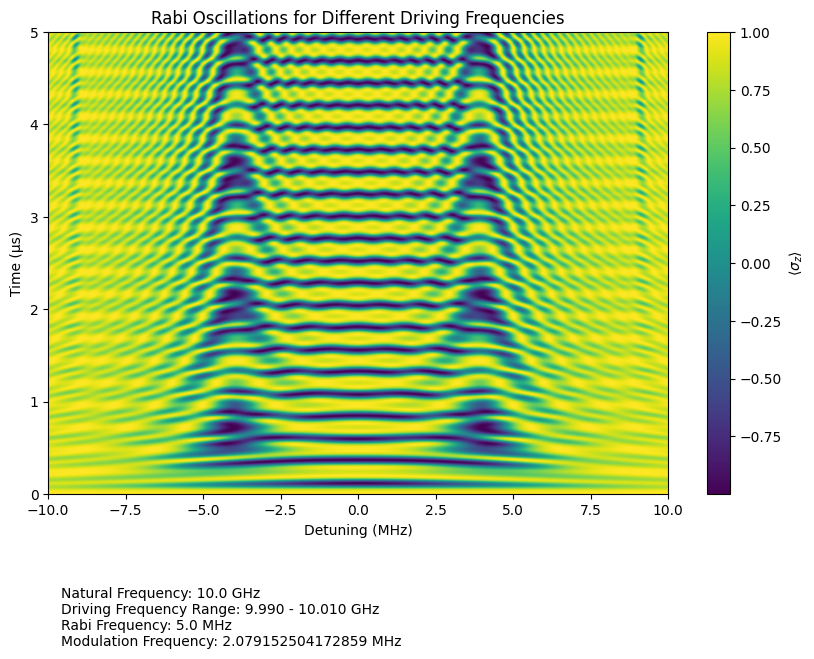

In [60]:
# Convert the list to a numpy array for easier plotting
z_expectations = np.array(z_expectations).T

# Calculate the detuning
detuning = (driving_freqs - natural_freq) / 1e6  # Convert to MHz

# Create the color plot
plt.figure(figsize=(10, 6))
plt.imshow(z_expectations, aspect='auto', extent=[detuning[0], detuning[-1], t_micro[0], t_micro[-1]], origin='lower', cmap='viridis')
plt.colorbar(label=r'$\langle\sigma_z\rangle$')
plt.xlabel('Detuning (MHz)')
plt.ylabel('Time (µs)')
plt.title('Rabi Oscillations for Different Driving Frequencies')

# Add metadata/caption with relevant frequencies
metadata = (f"Natural Frequency: {natural_freq / 1e9} GHz\n"
           f"Driving Frequency Range: {driving_freqs[0] / 1e9:.3f} - {driving_freqs[-1] / 1e9:.3f} GHz\n"
           f"Rabi Frequency: {rabi_freq / 1e6} MHz\n"
           f"Modulation Frequency: {modulation_freq / 1e6} MHz")

plt.text(0.02, -0.2, metadata, transform=plt.gca().transAxes, 
         fontsize=10, verticalalignment='top')
plt.show()


paper ideal value for ration of mod to rabi freq

## Multithreading Rabi Chevron


omega_r and omega are different - i think omega is the one you wanna be thinking about??
$ \Omega = \Omega_r * \sqrt 2$

In [22]:
# Define frequencies
natural_freq = 10 * 10**9
driving_freq = 10 * 10**9
rabi_freq = 5*10**6  # Rabi frequency
modulation_freq = rabi_freq*np.sqrt(2)/2.404826 # Modulation frequency


# Initialize Hamiltonian and Quantum System
hamiltonian = Quantum_Hamiltonian(rabi_freq, 1, np.array([natural_freq]))
system = Quantum_System(hamiltonian, 1)


In [23]:
import multiprocessing as mp
from functools import partial


evaluation_points = 1000
evaluation_time = 1*10**-5
initial_state = np.array([0 + 0j, 1 + 0j])

# Define a range of driving frequencies
driving_freqs = np.linspace(9.98e9, 10.02e9, 1000)

# Set up the pool with number of cores
num_cores = mp.cpu_count()  # Use all available cores
print(f"Number of cores: {num_cores}")
pool = mp.Pool(num_cores)

# Create partial function with fixed parameters
evolve_partial = partial(system.evolve_for_frequency_smart,
                        initial_state=initial_state,
                        evaluation_time=evaluation_time,
                        evaluation_points=evaluation_points,
                        modulation_freq=modulation_freq)

# Run the calculations in parallel
z_expectations = pool.map(evolve_partial, driving_freqs)

# Close the pool
pool.close()
pool.join()

# z_expectations is now a list of results for each frequency

Number of cores: 8


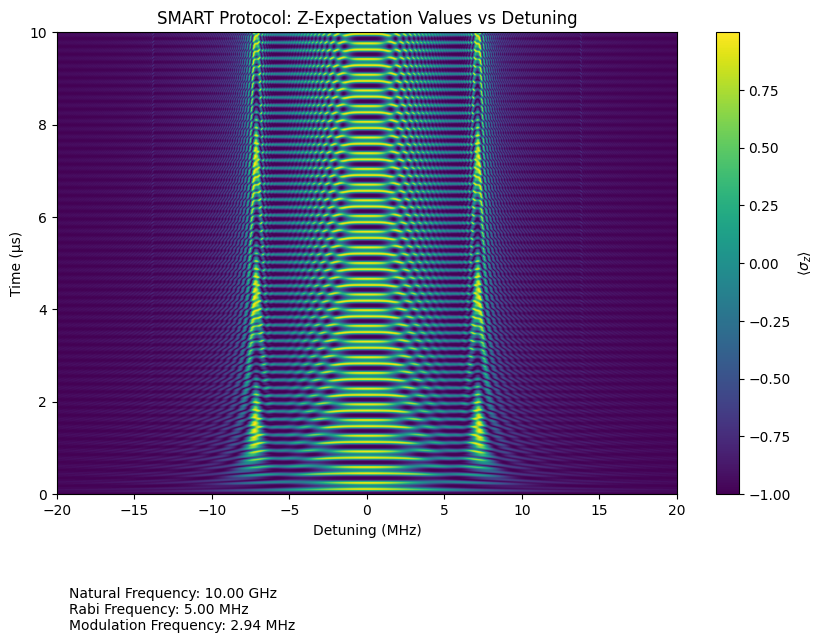

In [24]:
# Convert z_expectations list to numpy array and transpose
z_exp_array = np.array(z_expectations).T

t = np.linspace(0, evaluation_time, evaluation_points)
t_micro = t * 10**6  # Convert to microseconds


# Create the color plot using the same time and detuning axes as before
plt.figure(figsize=(10, 6))
plt.imshow(z_exp_array, aspect='auto', 
           extent=[(driving_freqs[0] - natural_freq)/1e6, 
                  (driving_freqs[-1] - natural_freq)/1e6, 
                  t_micro[0], t_micro[-1]], 
           origin='lower', cmap='viridis')

plt.colorbar(label=r'$\langle\sigma_z\rangle$')
plt.xlabel('Detuning (MHz)')
plt.ylabel('Time (µs)')
plt.title('SMART Protocol: Z-Expectation Values vs Detuning')

# Add metadata
metadata = (f"Natural Frequency: {natural_freq/1e9:.2f} GHz\n"
           f"Rabi Frequency: {rabi_freq/1e6:.2f} MHz\n"
           f"Modulation Frequency: {modulation_freq/1e6:.2f} MHz")

plt.text(0.02, -0.2, metadata, transform=plt.gca().transAxes, 
         fontsize=10, verticalalignment='top')
plt.show()